






                                                                        Brady Gehrman
                                                                      CSE 625 Project 2
                                                                  Date Submitted: 6/29/2023












Problem 1: Using the CSV file, compute two vectors of strings called male_faces and female_faces, respectively, where male_faces contains the jpg file names of all male faces and female_faces contains the jpg file names of all female faces in the celebA dataset, respectively. 

Ex.

male_faces = [ "000003.jpg", "000007.jpg", "000008.jpg", ... ]
 and
female_faces = [ "000001.jpg", "000002.jpg", "000004.jpg", ... ]

In [143]:
using DataFrames
using FileIO
using Images
using Colors
using Plots

In [144]:
df = DataFrame(load("list_attr_celeba_2.csv"));

In [145]:
filteredDf = select(df, [:id, :Male])

Row,id,Male
,String,Int64
1,000001.jpg,0
2,000002.jpg,0
3,000003.jpg,1
4,000004.jpg,0
5,000005.jpg,0
6,000006.jpg,0
7,000007.jpg,1
8,000008.jpg,1
9,000009.jpg,0


In [146]:
male_faces = filter(row -> row.Male == 1, filteredDf)[:, :id]

84434-element Vector{String}:
 "000003.jpg"
 "000007.jpg"
 "000008.jpg"
 "000012.jpg"
 "000013.jpg"
 "000015.jpg"
 "000016.jpg"
 "000020.jpg"
 "000021.jpg"
 "000023.jpg"
 ⋮
 "202570.jpg"
 "202581.jpg"
 "202585.jpg"
 "202586.jpg"
 "202588.jpg"
 "202589.jpg"
 "202590.jpg"
 "202596.jpg"
 "202597.jpg"

In [147]:
female_faces = filter(row -> row.Male == 0, filteredDf)[:, :id]

118165-element Vector{String}:
 "000001.jpg"
 "000002.jpg"
 "000004.jpg"
 "000005.jpg"
 "000006.jpg"
 "000009.jpg"
 "000010.jpg"
 "000011.jpg"
 "000014.jpg"
 "000017.jpg"
 ⋮
 "202584.jpg"
 "202587.jpg"
 "202591.jpg"
 "202592.jpg"
 "202593.jpg"
 "202594.jpg"
 "202595.jpg"
 "202598.jpg"
 "202599.jpg"

1.2: Display last three female and last three male faces, respectively.

In [148]:
last_3_male_faces = male_faces[end-2:end]

3-element Vector{String}:
 "202590.jpg"
 "202596.jpg"
 "202597.jpg"

In [149]:
last_3_female_faces = female_faces[end-2:end]

3-element Vector{String}:
 "202595.jpg"
 "202598.jpg"
 "202599.jpg"

In [150]:
using Images 

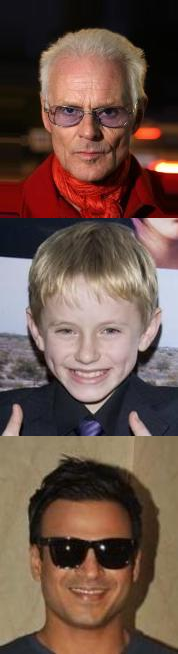

In [151]:
last_3_male_images = [load("./img_align_celeba/$name") for name in last_3_male_faces]
mosaicview(last_3_male_images)

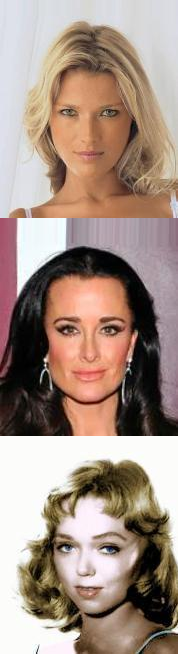

In [152]:
last_3_female_images = [load("./img_align_celeba/$name") for name in last_3_female_faces]
mosaicview(last_3_female_images)

2.1: Use the Hwloc.jl package to display the configuration of the computer you use for the project. Displayed info should include: number of CPU physical
and virtual cores, RAM size, and cache info.

In [153]:
using Hwloc

In [154]:
num_physical_cores()

4

In [155]:
num_virtual_cores()

8

In [156]:
getinfo()

Dict{Symbol, Int64} with 8 entries:
  :L2Cache  => 4
  :NUMANode => 1
  :Core     => 4
  :Package  => 1
  :L1Cache  => 4
  :Machine  => 1
  :PU       => 8
  :L3Cache  => 1

In [157]:
cachesize()

(L1 = 32768, L2 = 262144, L3 = 8388608)

In [158]:
cachelinesize()

(L1 = 64, L2 = 64, L3 = 64)

In [159]:
topology()

Machine (3.35 GB)
    Package L#0 P#-1 (3.35 GB)
        NUMANode (3.35 GB)
        L3 (8.0 MB)
            L2 (256.0 kB) + L1 (32.0 kB) + Core L#0 P#-1 
                PU L#0 P#0 
                PU L#1 P#1 
            L2 (256.0 kB) + L1 (32.0 kB) + Core L#1 P#-1 
                PU L#2 P#2 
                PU L#3 P#3 
            L2 (256.0 kB) + L1 (32.0 kB) + Core L#2 P#-1 
                PU L#4 P#4 
                PU L#5 P#5 
            L2 (256.0 kB) + L1 (32.0 kB) + Core L#3 P#-1 
                PU L#6 P#6 
                PU L#7 P#7 

In [160]:
topology_graphical()

/--------------------------------------------------------------------\
| Machine (3492MB total)                                             |
|                                                                    |
| /----------------------------------------------------------------\ |
| | Package L#0                                                    | |
| |                                                                | |
| | /------------------------------------------------------------\ | |
| | | NUMANode L#0 P#0 (3492MB)                                  | | |
| | \------------------------------------------------------------/ | |
| |                                                                | |
| | /------------------------------------------------------------\ | |
| | | L3 (8192KB)                                                | | |
| | \------------------------------------------------------------/ | |
| |                                                                | |
| | /-

2.2: Compute mean face of female celebA faces and male celebA faces respectively

In [161]:
N = 100

100

In [162]:
male_images_paths = ["./img_align_celeba/$name" for name in male_faces]

84434-element Vector{String}:
 "./img_align_celeba/000003.jpg"
 "./img_align_celeba/000007.jpg"
 "./img_align_celeba/000008.jpg"
 "./img_align_celeba/000012.jpg"
 "./img_align_celeba/000013.jpg"
 "./img_align_celeba/000015.jpg"
 "./img_align_celeba/000016.jpg"
 "./img_align_celeba/000020.jpg"
 "./img_align_celeba/000021.jpg"
 "./img_align_celeba/000023.jpg"
 ⋮
 "./img_align_celeba/202570.jpg"
 "./img_align_celeba/202581.jpg"
 "./img_align_celeba/202585.jpg"
 "./img_align_celeba/202586.jpg"
 "./img_align_celeba/202588.jpg"
 "./img_align_celeba/202589.jpg"
 "./img_align_celeba/202590.jpg"
 "./img_align_celeba/202596.jpg"
 "./img_align_celeba/202597.jpg"

In [163]:
female_images_paths = ["./img_align_celeba/$name" for name in female_faces]

118165-element Vector{String}:
 "./img_align_celeba/000001.jpg"
 "./img_align_celeba/000002.jpg"
 "./img_align_celeba/000004.jpg"
 "./img_align_celeba/000005.jpg"
 "./img_align_celeba/000006.jpg"
 "./img_align_celeba/000009.jpg"
 "./img_align_celeba/000010.jpg"
 "./img_align_celeba/000011.jpg"
 "./img_align_celeba/000014.jpg"
 "./img_align_celeba/000017.jpg"
 ⋮
 "./img_align_celeba/202584.jpg"
 "./img_align_celeba/202587.jpg"
 "./img_align_celeba/202591.jpg"
 "./img_align_celeba/202592.jpg"
 "./img_align_celeba/202593.jpg"
 "./img_align_celeba/202594.jpg"
 "./img_align_celeba/202595.jpg"
 "./img_align_celeba/202598.jpg"
 "./img_align_celeba/202599.jpg"

In [164]:
using Base.Threads

In [165]:
nthreads()

4

  0.256597 seconds (33.44 k allocations: 25.151 MiB, 26.27% compilation time)


,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

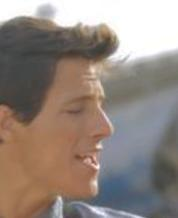
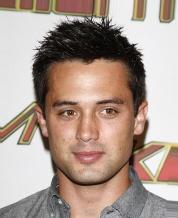
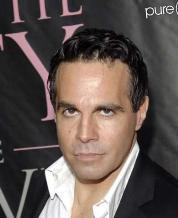
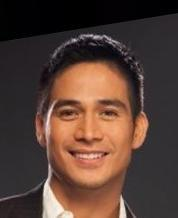
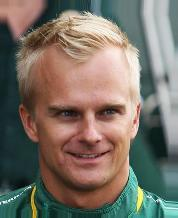
...
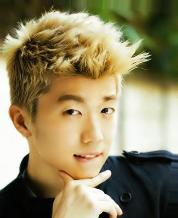
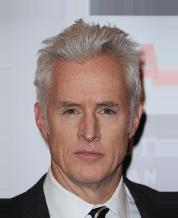
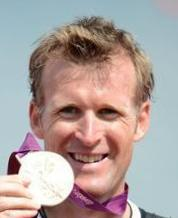
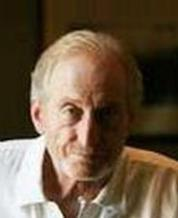
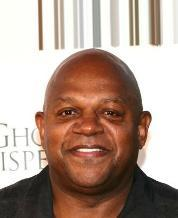

In [166]:
# Load (N) male faces into a Vector of RGB Images 
vector_male_faces = Vector{Matrix{RGB{N0f8}}}([])
@time vector_male_faces = [load(f) for f in male_images_paths[1:N]]
vector_male_faces

In [167]:
typeof(vector_male_faces)

Vector{Matrix{RGB{N0f8}}} (alias for Array{Array{RGB{Normed{UInt8, 8}}, 2}, 1})

  0.146758 seconds (27.26 k allocations: 24.787 MiB, 128.02% compilation time)


,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

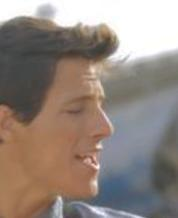
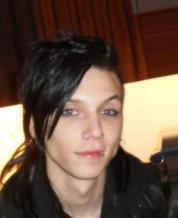
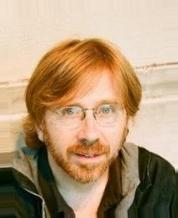
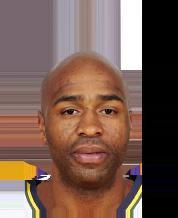
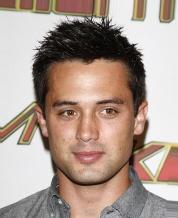
...
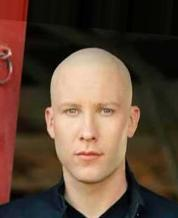
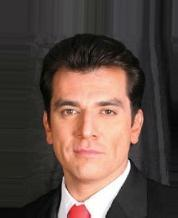
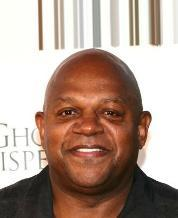
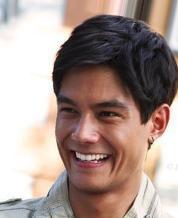
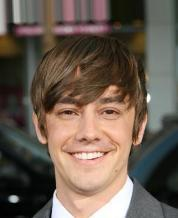

In [168]:
# Load (N) male faces into a Vector of RGB Images using multithreading
vector_male_faces_p = Vector{Matrix{RGB{N0f8}}}([])
@time @threads for f in male_images_paths[1:N]
    push!(vector_male_faces_p, load(f))
end
vector_male_faces_p

  0.256520 seconds (33.44 k allocations: 25.233 MiB, 45.93% compilation time)


,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

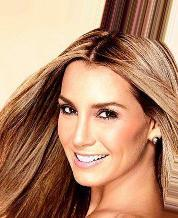
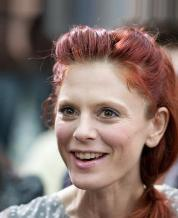
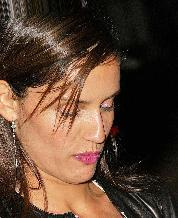
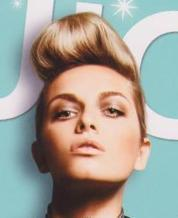
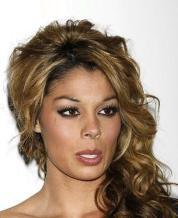
...
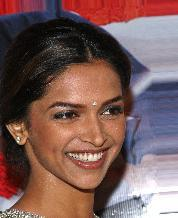
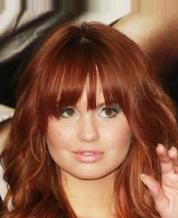
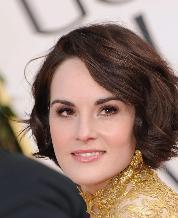
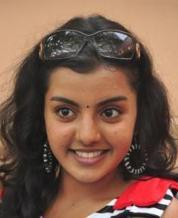
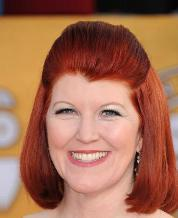

In [169]:
# Load (N) female faces into a Vector of RGB Images 
vector_female_faces = Vector{Matrix{RGB{N0f8}}}([])
@time vector_female_faces = [load(f) for f in female_images_paths[1:N]]

  0.191251 seconds (27.27 k allocations: 24.870 MiB, 104.31% compilation time)


,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

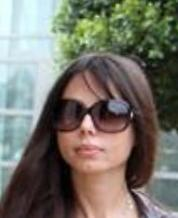
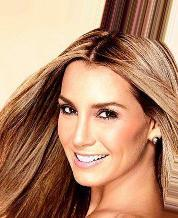
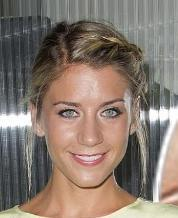
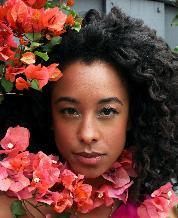
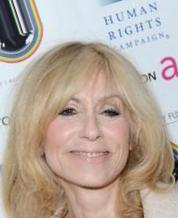
...
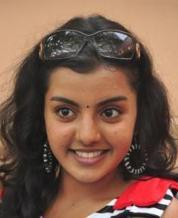
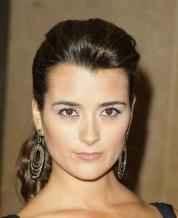
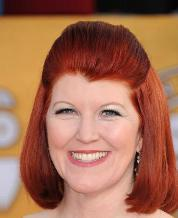
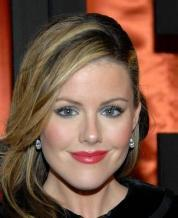
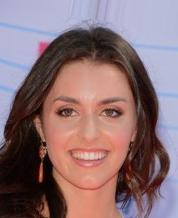

In [170]:
# Load (N) female faces into a Vector of RGB Images using multithreading
vector_female_faces_p = Vector{Matrix{RGB{N0f8}}}([])
@time @threads for f in female_images_paths[1:N]
    push!(vector_female_faces_p, load(f))
end
vector_female_faces_p

In [171]:
using Statistics

In [172]:
function mean_RGB(args...)
    
    c = RGB{Float64}(0,0,0)    
    w = 1.0 / length(args)
    c = sum([w * arg for arg in args])
    
    return RGB{N0f8}(c)
end

mean_RGB (generic function with 1 method)

In [173]:
function mean_RGB_threads(args...)
    c = RGB{Float64}(0,0,0)    
    w = 1.0 / length(args)
    @threads for arg in args
       c += w * arg
    end
    
    return RGB{N0f8}(c)
end

mean_RGB_threads (generic function with 2 methods)

In [174]:
function mean_RGB_simd(args...)
    c = RGB{Float64}(0,0,0)    
    w = 1.0 / length(args)
    @simd for arg in args
       c += w * arg
    end
    
    return RGB{N0f8}(c)
end

mean_RGB_simd (generic function with 1 method)

Display "mean faces" for N male pictures

 37.771852 seconds (368.18 M allocations: 16.753 GiB, 10.22% gc time, 8.85% compilation time: 93% of which was recompilation)


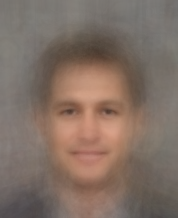

In [175]:
#calculating mean faces using sequential sum
@time vector_mean = mean_RGB.(vector_male_faces...)

 37.672473 seconds (374.30 M allocations: 17.011 GiB, 10.23% gc time, 0.81% compilation time)


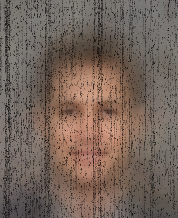

In [176]:
#calculating mean faces using threads
@time vector_mean = mean_RGB_threads.(vector_male_faces...)

 33.842946 seconds (368.01 M allocations: 16.633 GiB, 10.11% gc time, 6.61% compilation time)


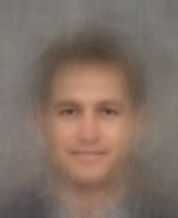

In [177]:
#calculating mean faces using simd
@time vector_mean = mean_RGB_simd.(vector_male_faces...)

Display "mean faces" for N female pictures

 38.439726 seconds (365.62 M allocations: 16.603 GiB, 10.08% gc time)


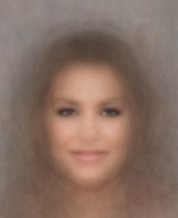

In [178]:
#calculating mean faces using sequential sum
@time vector_mean = mean_RGB.(vector_female_faces...)

 35.986502 seconds (374.27 M allocations: 17.009 GiB, 10.46% gc time)


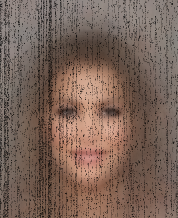

In [179]:
#calculating mean faces using threads
@time vector_mean = mean_RGB_threads.(vector_female_faces...)

 27.479071 seconds (365.42 M allocations: 16.484 GiB, 10.55% gc time)


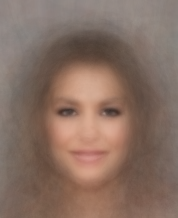

In [180]:
#calculating mean faces using simd
@time vector_mean = mean_RGB_simd.(vector_female_faces...)

1. Document the data structures used: Images stored in Vector{Matrix{RGB{N0f8}}}, which is the best option for images of different sizes when finding mean face.

2. Document how the face files are read: The face files are read one at a time from the img_align folder, we used the load function to load the jpg images, which are then stored inside of a Vector{Matrix{RGB{N0f8}}} data structure.

3. Document how the mean faces are computed in your project notebook: After the images are stored in a Vector{Matrix{RGB{N0f8}}} data structure, the vector is seperated and then inputted into the mean_RGB function. This function iterates through each of the stored images and computes the mean pixel color for each pixel within the images, later returning the mean face image for the collection of arguments that it receives.

4. Measure the runtimes of files read and mean faces computation:

Dell Laptop:

Sequential:
N = 100:
male files read-time: 1.834805 seconds,
female files read-time: 2.126018 seconds

male files mean-face runtime: 37.771852 seconds,
female files mean-face runtime: 38.439726 seconds

Using Multithreading:
N = 100:
male files read-time: 0.124658 seconds,
female files read-time: 0.110907 seconds

male files mean-face runtime:  37.672473 seconds,
female files mean-face runtime:  35.986502 seconds

Using Simd:
N = 100:
male files mean-face runtime: 33.842946 seconds,
female files mean-face runtime: 28.479071 seconds

Desktop PC:

N = 100:
male files read-time: 0.100307 seconds,
female files read-time: 0.093811 seconds

male files mean-face runtime: 15.091348 seconds,
female files mean-face runtime: 13.247546 seconds

N = 200:
male files read-time: 0.159943 seconds,
female files read-time: 0.170356 seconds

male files mean-face runtime: 63.206484 seconds,
female files mean-face runtime: 57.844923 seconds

N = 500:
male files read-time: 0.404757 seconds,
female files read-time: 0.370148 seconds

male files mean-face runtime: 431.732230 seconds,
female files mean-face runtime: 385.163142 seconds

P.S. these mean-face functions could have utilized the Julia's threads library to speed up the
execution time of these trials, it was not listed in the project description, but it was used to enhance this project. 
The multithreaded solution isn't fully immplemented because it happens to not increase the runtime by that much. 
